### Performing Principal Component Analysis on MNIST dataset

My article on Understanding Principal Component Analysis from scratch in medium-

https://medium.com/@srivatsansabarish/understanding-principal-component-analysis-from-scratch-b5bfbaccab87?sk=e464021c35edebe9200f5a37af73ed66

In [46]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [47]:
df=pd.read_csv("mnist_train.csv")

In [48]:
df.shape

(60000, 785)

In [49]:
df.head()

,label,1x1,1x2,1x3,1x4,1x5,1x6,1x7,1x8,1x9,...,28x19,28x20,28x21,28x22,28x23,28x24,28x25,28x26,28x27,28x28
0,5,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


#### Extracting labels from the dataset for later use as we should not perform PCA on it.

In [51]:
label = df['label']

In [52]:
#dropping the label
df_new = df.drop(["label"],axis=1)

In [53]:
df_new.shape

(60000, 784)

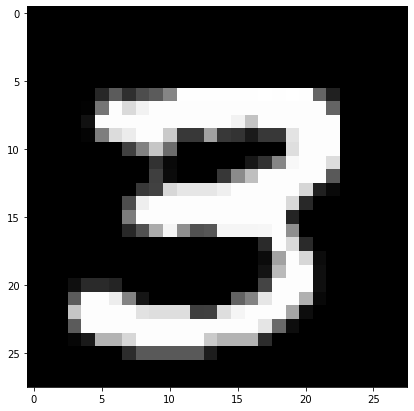

3


In [172]:
# visualizing the data by reshape from 1d to 2d pixel array

plt.figure(figsize=(7,7))
idx = 111

grid_data = df_new.iloc[idx].to_numpy().reshape(28,28)  # reshape from 1d to 2d pixel array
plt.imshow(grid_data, interpolation = "none", cmap = "gray")
plt.show()

print(label[idx])

## PCA
Principal Component Analysis  is a dimensionality-reduction method that is used to reduce the dimensionality of large data sets by transforming a large set of variables into a smaller one that still contains most of the information in the large set.

Steps involved in PCA:

1.Standardization the data

2.Covariance Matrix Computation

3.Calculating the Eigenvectors and Eigenvalues of the Covariance Matrix to identify the principal components

4.Compute the percentage of variance by each eigen values.

5.Reducing the Dimensions of the dataset

6.Reorient the data along the Principal Components Axes


### Step 1: Standardizing the data

We need to standardize the range of continuous variables so that each of them lies in a similar range. The Reason behind this if there are 2 variables A and B, variable A ranges between 0 and 1000 will dominate over a variable B that ranges between 0 and 1, which will lead to biased results. 

Standardization rescales data to have a mean of 0 and a standard deviation of 1.

### Z= Value - Mean / Standard Deviation 

In [ ]:
class StandardScaler(object):
    def __init__(self):
        pass

    def fit(self, X):
        self.mean_ = np.mean(X, axis=0) # mean value of particular column
        self.scale_ = np.std(X - self.mean_, axis=0) # standard deviation of particular column
        return self

    def transform(self, X):
        return (X - self.mean_) / self.scale_

    def fit_transform(self, X):
        return self.fit(X).transform(X)
    
    #fit method learns the model parameters (for example, mean and standard deviation)
    #transform method applies the transformation to any particular set

In [58]:
standardized_data = StandardScaler(df_new)
print(standardized_data)

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


### Step 2: Covariance Matrix Computation

The main of the step is to understand how the variables of the input data set are varying from the mean with respect to each other. Because sometimes, variables are highly correlated in such a way that they contain redundant information. So, in order to identify these correlations, we compute the covariance matrix.

The covariance matrix contains the variances and covariances associated with several variables. The diagonal elements of the matrix contain the variances of each individual variables ( Since the covariance of a variable with itself is its variance (Cov(x, x)=Var(x)) ), and the off-diagonal elements contain the covariances between all possible pairs of variables.

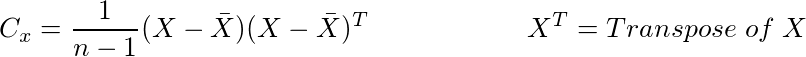

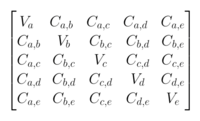

#### This is how the covariance matrix looks like for 5 dimensions

In [61]:
mean_vector = np.mean(standardized_data, axis=0)
cov_mat = (standardized_data - mean_vector).T.dot((standardized_data - mean_vector)) / (standardized_data.shape[0]-1)
print('Covariance matrix \n%s' %cov_mat)

Covariance matrix 
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [62]:
mean_vector

array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -1.03620816e-18,  1.62832710e-18, -1.53950926e-18, -8.28966525e-19,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -1.53950926e-18, -8.88178420e-20, -8.28966525e-19, -1.18423789e-18,
       -3.90798505e-18,  4.20404452e-18, -6.15803704e-18, -5.21064673e-18,
       -6.15803704e-18, -1.27897692e-17, -4.85537536e-18, -1.23160741e-17,
        7.34227494e-18,  2.36847579e-18, -2.60532336e-18, -4.02640884e-18,
        4.02640884e-18,  2.13162821e-18,  8.28966525e-19, -2.25005200e-18,
        0.00000000e+00,  

In [63]:
## Default covariance matrix function available in numpy. Both formula and default function produces same result.

print('NumPy covariance matrix: \n%s' %np.cov(standardized_data.T))

NumPy covariance matrix: 
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


### Step 3: Calculating the Eigenvectors and Eigenvalues of the Covariance Matrix to identify the principal components

Eigenvectors and eigenvalues are something that we need to compute from the covariance matrix in order to determine the principal components of the data.

Eigen Value is the scalar that is used to transform or stretch an eigenvector. It captures the data variability as much as possible in the first principal components analysis.

Principal components are nothing but the linear combination of initial variables.

These combinations are done in such a way that the new variables (i.e., principal components) are uncorrelated and most of the information within the initial variables is squeezed or compressed into the first components. So, the idea is 50-dimensional data gives you 50 principal components, but PCA tries to put maximum possible information in the first component, then maximum remaining information in the second and so on.

In [66]:
eig_vals, eig_vecs = np.linalg.eig(cov_mat)
# linear algebric equation for eigen vectors and eigne values

print('Eigenvectors \n%s' %eig_vecs)


Eigenvectors 
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 1.]]


In [174]:
eig_vecs.shape

(784, 784)

In [67]:
print('\nEigenvalues \n%s' %eig_vals)


Eigenvalues 
[ 4.04876351e+01  2.92416975e+01  2.68118045e+01  2.06866182e+01
  1.80766501e+01  1.57331779e+01  1.37906091e+01  1.25175891e+01
  1.10067953e+01  1.00504971e+01  9.62045779e+00  8.63097356e+00
  7.99159687e+00  7.81488215e+00  7.37553786e+00  7.13058751e+00
  6.71398002e+00  6.60400749e+00  6.40604846e+00  6.23737743e+00
  5.93229172e+00  5.76059855e+00  5.48403364e+00  5.31859721e+00
  5.12873534e+00  4.96062446e+00  4.90533662e+00  4.70843497e+00
  4.52919760e+00  4.39470849e+00  4.27522172e+00  4.21399693e+00
  4.09838079e+00  4.03181137e+00  3.97713624e+00  3.86052409e+00
  3.80864021e+00  3.72563426e+00  3.64393543e+00  3.44169730e+00
  3.41624517e+00  3.36378527e+00  3.25773631e+00  3.23620323e+00
  3.20478100e+00  3.17911021e+00  3.14205728e+00  3.08588859e+00
  3.06076556e+00  3.03759974e+00  2.90171955e+00  2.86408562e+00
  2.84980787e+00  2.82374220e+00  2.76632955e+00  2.71778127e+00
  2.69168208e+00  2.65850712e+00  2.61669482e+00  2.57622805e+00
  2.4937220

In [88]:
# Make a list of (eigenvalue, eigenvector) tuples
eig_pairs = [(np.abs(eig_vals[i]), eig_vecs[:,i]) for i in range(len(eig_vals))]

# Sort the (eigenvalue, eigenvector) tuples from high to low
eig_pairs.sort(key=lambda x: x[0], reverse=True)

# Sorted by decreasing eigenvalues
print('Eigenvalues in descending order:')
for i in eig_pairs:
    print(i[0])

Eigenvalues in descending order:
40.487635108466726
29.24169751894913
26.811804486217675
20.68661822000471
18.07665012343688
15.733177866400196
13.790609093485152
12.517589094135074
11.006795270542002
10.050497052251036
9.62045779343591
8.630973555525987
7.991596865094686
7.814882145374662
7.375537858882728
7.130587505186209
6.713980018771323
6.604007488656397
6.406048463262658
6.237377432789747
5.932291718046737
5.760598548468991
5.484033638105176
5.31859720962407
5.128735342290079
4.9606244586807895
4.905336616857889
4.708434970274745
4.529197596407844
4.39470849175558
4.27522172153255
4.213996933512852
4.098380789692774
4.031811372993938
3.977136242957303
3.860524085232526
3.808640207391617
3.725634258016613
3.6439354278067637
3.441697304217117
3.4162451668302727
3.3637852743015118
3.2577363106526542
3.236203226179955
3.20478099896225
3.1791102096417507
3.1420572768010104
3.085888587798769
3.060765560326998
3.0375997399469057
2.901719551936632
2.864085617837815
2.849807870292288
2.8

In [173]:
# eig _pairs have both eigen vectors and values
eig_pairs

[(40.487635108466726,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
          9.36760474e-05, -1.67076577e-05, -1.51736771e-04, -1.51736771e-04,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         -4.10427763e-04, -5.57713521e-04, -1.44637186e-03, -2.06746188e-03,
         -3.11510893e-03, -4.18512786e-03, -4.17930027e-03, -3.76567989e-03,
         -3.10864021e-03, -2.53192104e-03, -2.46458967e-03, -1.68414105e-03,
         -1.02887437e-03, -6.74195801e-04, -2.76199891e-04,  5.07037901e-04,
          3.33055762e-04, -3.62075624e-04, -2.33337615

###  Step 4: Compute the percentage of variance by each eigen value

After having the eigen values, to compute the percentage of variance or information accounted for by each values, we divide the eigenvalue of each component by the sum of eigenvalues. If we apply this we can find the percentage of variance on each eigen value.

- Dividing each component eig_vals by total sum provides the percentage of variance captured by each eigen value.

In [72]:
tot = sum(eig_vals)
var_exp = [(i / tot)*100 for i in sorted(eig_vals, reverse=True)]
print("Variance captured by each component is \n",var_exp)

Variance captured by each component is 
 [5.646716919741735, 4.078271988469149, 3.7393804215912914, 2.8851148456114877, 2.521108625653391, 2.1942699646818804, 1.9233443863319741, 1.7457992284030914, 1.5350923045961162, 1.4017196016690134, 1.341743019870667, 1.203741939465373, 1.1145695497647974, 1.0899235561142124, 1.028649223605543, 0.9944865637463206, 0.9363832802098104, 0.9210456655320665, 0.8934367776552673, 0.8699126187586049, 0.8273630190401813, 0.8034173693853808, 0.7648455003548869, 0.7417724639243012, 0.7152928679731806, 0.6918468314653383, 0.6841359639118, 0.6566745462145845, 0.6316767238188612, 0.6129198391372452, 0.5962552953747823, 0.5877164156528069, 0.5715916992114752, 0.5623074164766695, 0.5546820024202582, 0.5384183742209815, 0.5311822496589714, 0.5196056016893041, 0.5082112546094326, 0.4800055707943345, 0.4764558200015096, 0.4691393600018975, 0.454348956073567, 0.45134578653549756, 0.44696340110817284, 0.443383155435368, 0.43821546850484366, 0.43038175123044686, 0.426

The cumulative variance of data is the sum of the variances of the data up to a required level.

In [73]:
cum_var_exp = np.cumsum(var_exp)
print("Cumulative variance captured as we travel each component \n",cum_var_exp)

Cumulative variance captured as we travel each component 
 [  5.64671692   9.72498891  13.46436933  16.34948418  18.8705928
  21.06486277  22.98820715  24.73400638  26.26909869  27.67081829
  29.01256131  30.21630325  31.3308728   32.42079635  33.44944558
  34.44393214  35.38031542  36.30136109  37.19479786  38.06471048
  38.8920735   39.69549087  40.46033637  41.20210883  41.9174017
  42.60924853  43.2933845   43.95005904  44.58173577  45.19465561
  45.7909109   46.37862732  46.95021902  47.51252643  48.06720844
  48.60562681  49.13680906  49.65641466  50.16462592  50.64463149
  51.12108731  51.59022667  52.04457562  52.49592141  52.94288481
  53.38626797  53.82448343  54.25486519  54.68174309  55.1053901
  55.51008622  55.90953363  56.30698975  56.70081055  57.08662414
  57.46566681  57.84106949  58.21184534  58.57678972  58.93609029
  59.28847246  59.6362661   59.98067741  60.32054553  60.65650007
  60.99138603  61.32324972  61.64627567  61.96255264  62.27579689
  62.58652833  62.89

#### 9.72% of the data variation are captured by the first 2 eigen vectors.

Arranging the Eigen values in Descending order

In [75]:
var_exp

[5.646716919741735,
 4.078271988469149,
 3.7393804215912914,
 2.8851148456114877,
 2.521108625653391,
 2.1942699646818804,
 1.9233443863319741,
 1.7457992284030914,
 1.5350923045961162,
 1.4017196016690134,
 1.341743019870667,
 1.203741939465373,
 1.1145695497647974,
 1.0899235561142124,
 1.028649223605543,
 0.9944865637463206,
 0.9363832802098104,
 0.9210456655320665,
 0.8934367776552673,
 0.8699126187586049,
 0.8273630190401813,
 0.8034173693853808,
 0.7648455003548869,
 0.7417724639243012,
 0.7152928679731806,
 0.6918468314653383,
 0.6841359639118,
 0.6566745462145845,
 0.6316767238188612,
 0.6129198391372452,
 0.5962552953747823,
 0.5877164156528069,
 0.5715916992114752,
 0.5623074164766695,
 0.5546820024202582,
 0.5384183742209815,
 0.5311822496589714,
 0.5196056016893041,
 0.5082112546094326,
 0.4800055707943345,
 0.4764558200015096,
 0.4691393600018975,
 0.454348956073567,
 0.45134578653549756,
 0.44696340110817284,
 0.443383155435368,
 0.43821546850484366,
 0.43038175123044686,

In [81]:
len(var_exp)

784

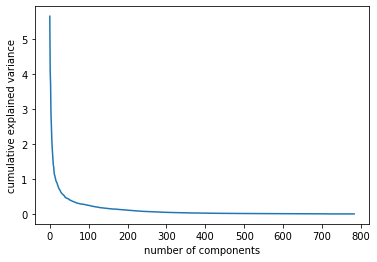

In [131]:
from matplotlib import pyplot as plt

#Explained variance
plt.plot(var_exp)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.show()

#### We can see that amount of variance captured by each component reduces as we increases the number of dimensions

### Step 5: Reducing the Dimensions of the dataset

it’s up to us to decide whether to keep all the components or remove the ones of lesser significance, depending on what we are looking for. Here we are going to choose only 2 eigen vectors.

In [96]:
# This shows the eigen values for 2nd principal component
eig_pairs[1][0]

29.24169751894913

In [97]:
# This shows the eigen vectors for 2nd principal component
eig_pairs[1][1]

array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        4.17510569e-04,  2.18278096e-04, -1.73423796e-04, -1.73423796e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        4.33051610e-05,  3.06541011e-04,  2.98335535e-03,  3.70059971e-03,
        4.17483375e-03,  4.65050724e-03,  4.63844653e-03,  4.45622716e-03,
        3.50554125e-03,  2.32197470e-03,  1.31456103e-03,  4.89005555e-05,
       -1.01921935e-03, -1.67142176e-03, -2.42714482e-03, -2.88716178e-03,
       -2.82563877e-03, -2.20384121e-03, -1.03207436e-03,  2.69992529e-04,
        0.00000000e+00,  

In [179]:
print ("Eigen Values along with Eigen Vectors",)
pprint.pprint(eig_pairs)

Eigen Values along with Eigen Vectors
[(40.487635108466726,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        9.36760474e-05, -1.67076577e-05, -1.51736771e-04, -1.51736771e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -4.10427763e-04, -5.57713521e-04, -1.44637186e-03, -2.06746188e-03,
       -3.11510893e-03, -4.18512786e-03, -4.17930027e-03, -3.76567989e-03,
       -3.10864021e-03, -2.53192104e-03, -2.46458967e-03, -1.68414105e-03,
       -1.02887437e-03, -6.74195801e-04, -2.76199891e-04,  5.07037901e-04,
        3.33055762e-04, -3.62075624e-0

 (5.932291718046737,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        3.64790594e-03,  1.84874615e-03, -1.61558638e-03, -1.61558638e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        6.87897690e-03,  8.69275537e-03,  2.00983725e-02,  2.24492851e-02,
        1.60052928e-02,  1.93463316e-02,  2.71570397e-02,  3.47491745e-02,
        3.27786002e-02,  2.40173647e-02,  1.76185864e-02,  1.10225168e-02,
        2.62507563e-03, -2.02041078e-03, -3.09112312e-03, -4.03624000e-03,
       -2.38825329e-03,  2.46960999e-03,  3.81304823e-03,  3.61856422e-03,
  

  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -3.46717664e-02, -5.65313125e-02, -5.15678576e-02, -5.15678576e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -3.29386159e-02, -3.81571820e-02, -5.47004412e-02, -5.45099400e-02,
       -2.21955152e-02, -1.22210788e-02, -1.88640583e-02, -3.82851775e-02,
       -5.86685944e-02, -7.66088495e-02, -6.51495699e-02, -3.07395736e-02,
       -5.36002390e-03,  3.09064204e-03,  1.29657144e-03, -8.91208122e-03,
       -1.09076792e-02, -6.90760122e-03, -3.57179628e-03, -6.12237837e-05,
        0.00000000e+00,

        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00])),
 (2.6166948225923674,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        9.71048975e-03,  4.48834275e-02,  6.43446032e-02,  6.43446032e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -5.17551279e-02, -5.93172679e-02, -4.68363133e-02, -1.56603101e-02,
        7.88148645e-02,  9.07802053e-02,  2.92424989e-02, -4.32170000e-02,
       -7.31317554e-02, -3.34321360e-02,  3.90614169e-02,  9.35235217e-02,
        9.70165604e-02,  6.59549883e-02,  2.19215685e-02,  8.97713287e-04

  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.17796035e-02,  1.22374859e-02,  5.54927672e-03,  5.54927672e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.22019124e-02,  1.65730123e-02,  3.44158145e-02,  2.33138122e-02,
       -2.43989407e-02, -2.83934167e-02, -1.61843749e-03,  1.75625979e-02,
        1.20012569e-02, -1.73776145e-02, -3.55715370e-02, -2.63336275e-02,
        9.15520228e-04,  1.71039603e-02,  8.99528395e-03, -1.15917302e-02,
       -1.03121597e-02,  2.28050010e-02,  2.92064368e-02,  1.49636996e-02,
        0.00000000e+00,

 (1.795736790268935,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        2.57791614e-02,  3.58416718e-02,  2.77079845e-02,  2.77079845e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        3.15533717e-02,  3.89496523e-02,  9.02363154e-02,  9.16236185e-02,
        2.88968622e-02, -7.81062564e-03, -2.00351699e-02, -1.05522077e-02,
       -1.22098995e-02, -5.24631953e-02, -1.11778110e-01, -1.47417569e-01,
       -1.16748674e-01, -4.11624237e-02,  3.89467477e-02,  8.90208585e-02,
        7.80496560e-02,  7.36834397e-03, -2.12360442e-02, -2.15709624e-02,
  

 (1.48658240234727,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -2.81281109e-02, -2.19138393e-02, -6.98213330e-04, -6.98213330e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -3.26653345e-02, -3.59439749e-02, -4.71277049e-02, -6.13299460e-02,
       -6.55755979e-02, -6.35338500e-02, -4.42294894e-02, -2.98000643e-02,
       -6.39326679e-03,  4.45458825e-02,  7.10660931e-02,  3.36974004e-02,
       -3.69113904e-02, -6.83675777e-02, -2.77828838e-02,  4.53962891e-02,
        4.89694320e-02, -2.70203480e-02, -6.34150591e-02, -5.26992826e-02,
   

        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00])),
 (1.2533137310530131,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -2.11667113e-01, -9.15910154e-02,  1.20679585e-01,  1.20679585e-01,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.49271588e-02,  1.24010259e-02, -1.23781835e-02,  1.56376267e-03,
        4.30424963e-02,  5.39548931e-02,  3.79835918e-02,  2.55869890e-02,
       -7.77056615e-03, -1.04320368e-02, -2.22467719e-02, -8.50427240e-02,
       -4.16413847e-02,  6.29181628e-02,  7.14075608e-02, -4.81371087e-02

  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        6.47218684e-03,  4.16640952e-03, -1.34391291e-03, -1.34391291e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -1.76451020e-02, -1.77307093e-02, -9.32026729e-03, -2.39670645e-02,
       -5.00201411e-02, -5.04791337e-02, -1.63429124e-02, -5.64567477e-04,
       -1.12245997e-02, -2.91420083e-02, -2.10461834e-02, -4.21467623e-05,
       -7.80640775e-03, -3.27841128e-02, -1.66815931e-02,  3.18400181e-02,
        2.87444153e-02, -1.92890752e-02, -1.70195279e-02,  2.89342346e-03,
        0.00000000e+00,

 (0.9738628881740715,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        2.66853691e-02,  1.26727876e-02, -1.32806939e-02, -1.32806939e-02,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        8.17728875e-03,  6.31438074e-03, -1.75262678e-02, -2.74162660e-02,
       -4.90386873e-02, -3.23635092e-02,  8.43082636e-03,  2.80182161e-03,
       -1.56405331e-02, -8.60549458e-03,  1.92636893e-02,  4.20819948e-02,
        1.45016316e-02, -1.64913985e-02,  6.67157406e-03,  4.72967826e-02,
        2.83402645e-02, -5.21217013e-02, -4.35487169e-02,  1.04171060e-03,
 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0.3020445909382331,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        3.11354917e-04, -2.23344574e-04, -7.92594516e-04, -7.92594516e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        3.46187342e-03, -2.75358899e-03, -2.19905165e-02,  3.06092577e-03,
        3.48100838e-02, -4.47572964e-02,  4.04193814e-02,  6.95897549e-03,
       -6.21934993e-02,  5.79197351e-02,  6.85202405e-04, -5.63908524e-02,
        8.46862045e-02, -5.22920403e-02, -1.37992210e-02,  9.22120350e-02,
       -6.79536384e-02, -3.03376671e-02,  4.96440295e-02, -2.74050456e-02,
   

        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00])),
 (0.25460400082880474,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        2.00690238e-03,  9.52931987e-04, -9.99027657e-04, -9.99027657e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.51202812e-03,  1.87175417e-03, -2.28038754e-03,  3.46334177e-03,
        1.24922155e-02, -6.31727334e-03,  8.36637732e-04,  6.63452082e-03,
       -1.34644237e-02,  8.57017122e-03,  5.26831890e-03, -1.41959068e-02,
        1.91194084e-02, -2.28144743e-03, -2.44326185e-03,  1.03719009e-0

 (0.21345380171061965,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -2.12374556e-03, -1.04093635e-03,  1.00132343e-03,  1.00132343e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.21921244e-03, -2.15272258e-03, -2.39711976e-05,  7.14322210e-03,
       -3.59123195e-03,  4.57283537e-03,  3.97192553e-04, -1.46618222e-02,
        1.42098409e-02, -5.81398977e-03, -9.70212139e-03,  1.06772996e-02,
       -1.92652857e-03,  2.52325429e-03, -9.51599054e-03,  5.87377751e-03,
       -1.93927946e-03, -3.67958301e-03,  4.36040565e-03, -1.83804928e-03,


 (0.18594702629270396,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -9.55362229e-04, -1.38880165e-03, -1.13081569e-03, -1.13081569e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -6.97593499e-04,  3.49171067e-04, -5.91188194e-03, -8.89224288e-04,
        2.52426217e-02, -3.96547143e-02,  3.32819066e-02, -7.90508263e-03,
       -1.04662560e-02,  1.58248985e-02, -1.35634310e-02, -5.61321783e-03,
        1.82829461e-02, -1.15753292e-02, -6.81601037e-04,  7.30164194e-03,
       -3.82189963e-03, -5.52167319e-04,  1.02432463e-02, -6.70624072e-03,


 (0.16118198840326922,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -5.26916405e-03, -2.04500145e-03,  3.40788063e-03,  3.40788063e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        6.59888388e-03, -4.83196218e-03, -4.32332652e-02,  3.10847527e-02,
        5.71028153e-02, -8.12626580e-02,  7.12880654e-02, -7.57902012e-02,
        4.66852621e-02, -4.61646473e-03, -3.33860028e-02,  5.87074644e-02,
       -9.64977516e-02,  9.46522651e-02, -8.02592215e-02,  4.27428576e-02,
       -8.83117822e-03, -5.82255284e-02,  7.33535976e-02, -4.45502089e-02,


 (0.14328342210582024,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        8.67402303e-04,  5.67488759e-04, -1.64468157e-04, -1.64468157e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -4.29975699e-03, -3.62440223e-03,  6.58506164e-03, -2.80225596e-03,
       -3.03733136e-02,  2.14233192e-02,  1.28109102e-03, -1.23664147e-02,
        7.69619334e-05,  8.26944006e-04, -1.90409625e-03, -1.53450104e-02,
        2.22245572e-02, -3.84725309e-02,  3.02467184e-02, -1.58447130e-02,
        1.23980987e-03,  1.04007924e-02, -1.92848463e-02,  1.07812943e-02,


        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00])),
 (0.12265619183677541,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        2.86450536e-04,  1.54819214e-04, -1.10292066e-04, -1.10292066e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        3.18105575e-03, -3.21431597e-03, -6.97246989e-03,  1.05311877e-02,
        1.72774004e-03, -1.29699822e-04, -2.75471540e-03,  6.12603935e-03,
        1.18264278e-04, -1.61874431e-03,  6.64714690e-03, -8.40805703e-03,
        1.11893592e-02,  9.71156949e-05,  1.72635955e-03,  2.91930643e-0

  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -1.03921869e-03, -8.34474131e-04, -6.84777809e-05, -6.84777808e-05,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -3.51625424e-03,  3.63050313e-03,  1.24285713e-02, -1.63774390e-02,
        8.92445440e-03,  1.17363713e-02, -2.76776149e-02,  3.57416623e-02,
       -2.05813836e-02,  1.21844697e-02,  4.59482461e-03, -1.23778770e-02,
        2.60614595e-02, -3.56224024e-02,  4.40566644e-02, -7.21729957e-02,
        7.82682528e-02, -8.83025532e-02,  8.66556266e-02, -5.21860749e-02,
        0.00000000e+00,

 (0.09867110401723359,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.42388864e-03,  4.11515720e-04, -1.16329846e-03, -1.16329846e-03,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        9.47492269e-03, -1.34213811e-02, -4.57942504e-02,  5.06210355e-02,
       -1.58206977e-02,  9.57873671e-03, -1.82856260e-02,  2.50597276e-02,
       -3.06163320e-02,  2.76138946e-02, -2.84023190e-02,  1.36282084e-02,
       -3.85672839e-03, -4.63763616e-03,  4.24990494e-03, -6.14426883e-03,
        7.95244573e-03, -1.52876516e-03, -2.10920890e-03,  5.94934822e-03,


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -1.32184972e-04,  1.99985429e-04,  5.17141696e-04,  5.17141696e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -8.03332035e-04,  1.01214364e-03,  4.12783503e-04,  1.17567424e-03,
        1.50517093e-03, -1.02423322e-03,  2.13680418e-03, -5.50606752e-04,
       -1.94903243e-03,  3.12069884e-03, -2.26849291e-03,  2.31985879e-03,
       -1.96680135e-03,  6.81324835e-04,  1.51285883e-03, -1.54259284e-03,
        2.21832315e-03, -9.79966619e-04,  1.00833101e-03, -5.15470294e-04,
        0.00000000e+00,  

 (0.04159738534101237,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.79686052e-03,  9.69587371e-04, -6.94542075e-04, -6.94542075e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -1.03140749e-03,  1.87384427e-03,  4.49223470e-03, -4.09089017e-03,
        5.83786634e-03, -2.01341754e-03, -1.09312774e-03,  2.37925575e-04,
       -2.67968339e-03,  5.57275370e-03, -2.25387535e-03,  2.06371455e-03,
       -2.41070896e-03,  1.20847068e-03,  9.78008718e-05, -2.07307098e-03,
        3.32272965e-03, -2.39649174e-03,  2.91609852e-03, -2.18332270e-03,


 (0.0371127801746623,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -2.37740129e-04, -1.03796424e-04,  1.33958835e-04,  1.33958835e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.55060737e-03, -2.15972431e-03, -7.66301218e-04, -2.27228266e-04,
       -2.68402834e-03,  4.36949420e-03, -4.23014578e-03,  3.42256328e-03,
       -2.34914403e-03,  1.39215167e-03,  5.80278336e-04, -2.49530113e-03,
        2.80133873e-03, -2.49500846e-03,  1.20435796e-03,  3.35741080e-03,
       -3.93002993e-03,  4.23483139e-03, -1.62986985e-04, -3.36547657e-04,
 

 (0.032103711602703006,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        7.08489018e-04,  6.57906954e-04,  1.99569846e-04,  1.99569846e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        6.13874131e-04,  7.32557861e-04,  5.85648468e-03, -6.35760937e-03,
        2.50119771e-03, -8.15319447e-04,  1.28755994e-03, -1.68428763e-03,
        1.53547770e-03, -1.32387226e-03,  1.41078017e-03, -4.84222924e-04,
       -4.76411417e-05,  3.29757190e-04, -2.49695566e-03,  2.86576103e-03,
       -2.50869394e-03,  2.49837801e-03, -2.00213953e-03,  1.63490337e-03,

 (0.027386922816569997,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        6.99291420e-05,  2.58722552e-04,  3.52574432e-04,  3.52574432e-04,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
       -4.41100307e-03,  2.63074481e-03, -9.75350388e-04,  1.88982002e-03,
       -3.25665304e-03,  1.74569581e-03, -4.06721740e-03,  4.77848998e-03,
       -9.78243387e-04,  1.46368237e-03, -1.83903644e-03, -3.42741795e-05,
       -4.72081866e-05, -2.73881140e-04, -1.24163983e-03, -8.22785555e-05,
       -6.72370030e-04, -1.68907282e-04,  2.21188662e-03, -2.45702178e-03,

        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00])),
 (0.02299898171782204,
  array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        7.25998289e-05,  9.94369497e-05,  7.54532377e-05,  7.54532377e-05,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        1.03117836e-03, -4.93407490e-04,  1.49109658e-03, -2.06740106e-04,
        1.01581081e-04,  1.13292099e-03, -1.23351727e-03,  1.78339896e-03,
       -1.59665975e-03,  1.02426884e-03, -1.18800290e-04, -3.89629040e-04,
       -1.24432725e-03,  1.29219244e-03, -1.17890660e-03,  1.11144431e-0

 (0.0,
  array([0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0

 (0.0,
  array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0

 (0.0,
  array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0

#### Reducing to the 2-dimensional dataset

eig_pairs [0] [1]- Extracts the eigen vectors 1 and transforms the data into 784 rows and 1 column. The same transformation method applies to eig_pairs [1] [1] and then stacking both columns horizontally.

In [182]:
final_matrix = np.hstack((eig_pairs[0][1].reshape(784,1),
                      eig_pairs[1][1].reshape(784,1)))

print ('Final_Matrix:\n', final_matrix)

Final_Matrix:
 [[0. 0.]
 [0. 0.]
 [0. 0.]
 ...
 [0. 0.]
 [0. 0.]
 [0. 0.]]


### Step 6: Reorient the data along the Principal Components Axes

The aim is to use the feature vector formed using the eigenvectors of the covariance matrix, to reorient the data from the original axes to the ones represented by the principal components. This can be done by multiplying the original standardised dataset by the 1st two eigen vectors.

### Principal Components = Eigen Vector * Standardised Dataset

In [181]:
final_data = standardized_data.dot(final_matrix)
print (final_data[0:20])

[[ 0.92215881 -4.81479035]
 [-8.70897698 -7.75440302]
 [-2.32838932  9.43133817]
 [ 6.58217331 -3.74631834]
 [ 5.1832512   3.13329712]
 [-2.19840211 -3.06836644]
 [ 6.77334369  0.82307934]
 [-1.92690853 -5.40626434]
 [ 7.82233526  0.19181   ]
 [ 3.22762585 -4.72642548]
 [ 3.14763535 -2.34811482]
 [ 4.06225314 -4.24202707]
 [-4.02693076 10.30018391]
 [-0.94971335 -3.99713076]
 [ 7.60803478 -0.31771169]
 [ 2.98510306 -0.4716202 ]
 [-1.951605   -0.54576564]
 [ 4.33430033 -6.48393456]
 [ 3.36269403 -1.19519257]
 [ 8.12762557 -2.09802933]]


#### This is how the final dataset looks like, Now we need to transform it into dataframe and merge the label column

In [105]:
final_data.shape

(60000, 2)

In [106]:
label.shape

(60000,)

In [107]:
pca_df = pd.DataFrame(data=final_data, columns=("1st_principal_component", "2nd_principal_component"))

In [108]:
pca_df

,1st_principal_component,2nd_principal_component
0,0.922159,-4.814790
1,-8.708977,-7.754403
2,-2.328389,9.431338
3,6.582173,-3.746318
4,5.183251,3.133297
...,...,...
59995,2.039339,-5.119129
59996,-0.607841,-6.498440
59997,3.777212,-3.230564
59998,-1.722369,-4.948125


In [109]:
pca_df.shape

(60000, 2)

In [110]:
label

0        5
1        0
2        4
3        1
4        9
        ..
59995    8
59996    3
59997    5
59998    6
59999    8
Name: label, Length: 60000, dtype: int64

In [111]:
pca_df_final=pd.concat([pca_df, label], axis=1)

In [112]:
pca_df_final

,1st_principal_component,2nd_principal_component,label
0,0.922159,-4.814790,5
1,-8.708977,-7.754403,0
2,-2.328389,9.431338,4
3,6.582173,-3.746318,1
4,5.183251,3.133297,9
...,...,...,...
59995,2.039339,-5.119129,8
59996,-0.607841,-6.498440,3
59997,3.777212,-3.230564,5
59998,-1.722369,-4.948125,6


### Visualizing the Data

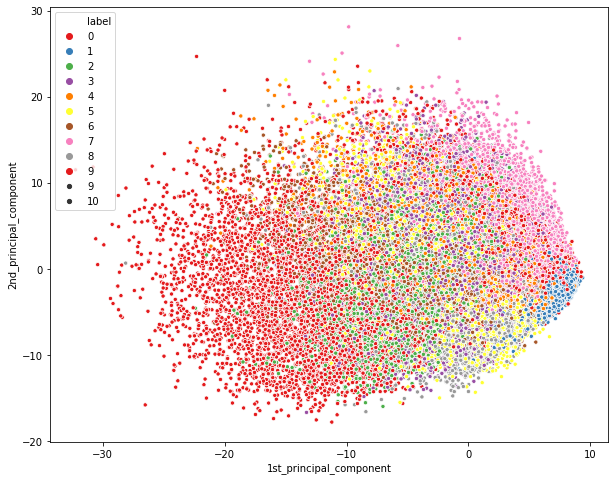

In [120]:
plt.figure(figsize=(10,8))
sns.scatterplot(data=pca_df_final,x="1st_principal_component",y="2nd_principal_component", hue="label", size=10,palette="Set1")

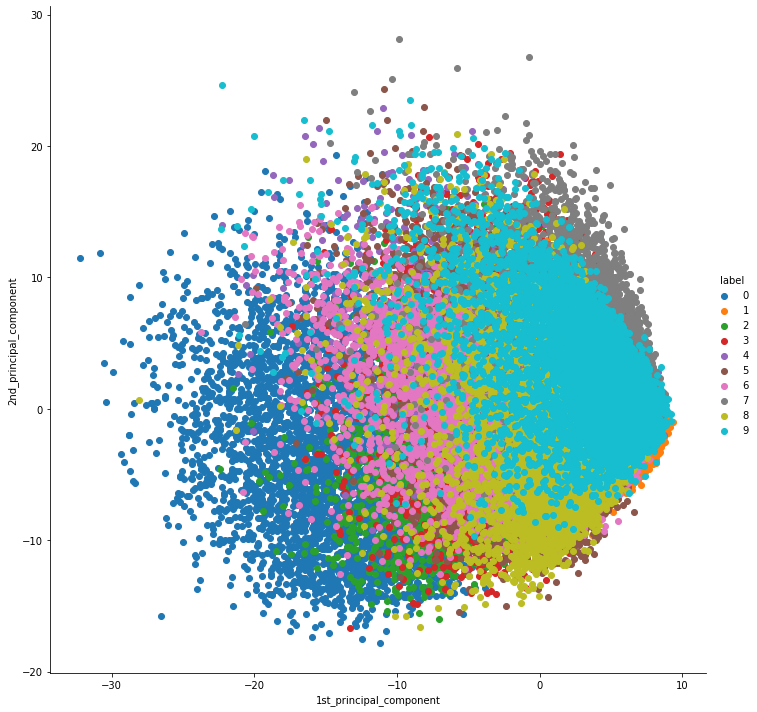

In [130]:
sns.FacetGrid(pca_df_final, hue="label", size=10).map(plt.scatter, '1st_principal_component', '2nd_principal_component').add_legend()
plt.show()

From the above two figures, we can observe that some variation was captured by the principal component. We projected along the two principal component axis and captured the structure in the points

The points belonging to the same class are close to each other, and the points that are very different are further away from each other.